# 'Exploratory Data Analysis Project on Global Terrorism Activities'


**Global Terrorism** refers to the illicit application of force or violence against individuals or assets with the intention of intimidating or coercing a government or its populace in order to advance specific political or social aims. 

Terrorism can be defined by the following characteristics:

- The utilization of violence or the threat of violence in the pursuit of goals related to politics, religion, ideology, or societal change.

- Actions perpetrated by entities outside of official government control (or by covert operatives acting on behalf of their respective governments).

- Actions that extend beyond immediate victims, affecting a broader segment of society.

The subsequent instances of violence or the threat of violence typically do not align with the definition of terrorism:

- Acts of violence, whether in wartime (even if undeclared) or peacetime, conducted by one nation-state against another, irrespective of their legal status, provided they are executed by duly recognized armed forces or lawful combatants of said nation-states.

- Justifiable acts of self-defense, which may involve the use of force to neutralize, apprehend, or penalize criminals who pose a danger to human lives or property.

- Lawful targets during times of war, such as enemy combatants and critical infrastructure integral to the enemy's war efforts, including defense-related industries and harbors.

- Unintended harm, including the accidental infliction of damage to non-combatant entities when attacking or attempting to attack legitimate wartime targets.

About DataSet - The dataset contains aprrox 180k of Terrorist activity reported under the time frame of 47 years that is from 1970 till 2017.
The dataset have 135 different informative parameters under which an activity has been reported.
These are -
DATE,COUNTRY,STATE,REGION,Number of people KILLED,TERRORIST GROUP responsible for the attack,Attack Types etc.

Now let's first Import required libaries and download the dataset and write it into a directory.

In [92]:
pip install RISE
pip install nbconvert

SyntaxError: invalid syntax (1604595794.py, line 1)

In [2]:
import plotly.express as px
import plotly.figure_factory as ff
import numpy as np
import pandas as pd
import opendatasets as od
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
%matplotlib inline

C:\Users\akgat\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\akgat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.FB5AE2TYXYH2IJRDKGDGQ3XBKLKTF43H.gfortran-win_amd64.dll
C:\Users\akgat\anaconda3\lib\site-packages\numpy\.libs\libopenblas64__v0.3.21-gcc_10_3_0.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [6]:
#Loading the downloaded dataset from the directory into a dataframe using the Pandas "pd.read_csv" function.
DF=pd.read_csv('globalterrorismdb_0718dist.csv',encoding='ISO-8859-1',low_memory=False)

In [7]:
DF.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


### Dataset Exploration

In [8]:
# DF is the datafrane that has been created with the loaded dataset.
# DF.shape function indicates the total number of rows & Columns.
DF.shape

(181691, 135)

In [9]:
# DataFrame ".coulmn" function gives us the total columns names that are present within the dataset.
DF.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [11]:
list(DF.columns)

['eventid',
 'iyear',
 'imonth',
 'iday',
 'approxdate',
 'extended',
 'resolution',
 'country',
 'country_txt',
 'region',
 'region_txt',
 'provstate',
 'city',
 'latitude',
 'longitude',
 'specificity',
 'vicinity',
 'location',
 'summary',
 'crit1',
 'crit2',
 'crit3',
 'doubtterr',
 'alternative',
 'alternative_txt',
 'multiple',
 'success',
 'suicide',
 'attacktype1',
 'attacktype1_txt',
 'attacktype2',
 'attacktype2_txt',
 'attacktype3',
 'attacktype3_txt',
 'targtype1',
 'targtype1_txt',
 'targsubtype1',
 'targsubtype1_txt',
 'corp1',
 'target1',
 'natlty1',
 'natlty1_txt',
 'targtype2',
 'targtype2_txt',
 'targsubtype2',
 'targsubtype2_txt',
 'corp2',
 'target2',
 'natlty2',
 'natlty2_txt',
 'targtype3',
 'targtype3_txt',
 'targsubtype3',
 'targsubtype3_txt',
 'corp3',
 'target3',
 'natlty3',
 'natlty3_txt',
 'gname',
 'gsubname',
 'gname2',
 'gsubname2',
 'gname3',
 'gsubname3',
 'motive',
 'guncertain1',
 'guncertain2',
 'guncertain3',
 'individual',
 'nperps',
 'nperpcap',
 

In [16]:
# DataFrame ".describe" method returns description of the data in the DataFrame.

# If the DataFrame contains numerical data, the description contains these information for each column:
# count - The number of not-empty values.
# mean - The average (mean) value.
# std - The standard deviation.
# min - the minimum value.
# 25% - The 25% percentile*.
# 50% - The 50% percentile*.
# 75% - The 75% percentile*.
# max - the maximum value.
# Percentile meaning: how many of the values are less than the given percentile.

DF.describe()

,eventid,iyear,imonth,iday,extended,country,region,latitude,longitude,specificity,...,ransomamt,ransomamtus,ransompaid,ransompaidus,hostkidoutcome,nreleased,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,181691.000000,177135.000000,1.771340e+05,181685.000000,...,1.350000e+03,5.630000e+02,7.740000e+02,552.000000,10991.000000,10400.000000,181691.000000,181691.000000,181691.000000,181691.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,131.968501,7.160938,23.498343,-4.586957e+02,1.451452,...,3.172530e+06,5.784865e+05,7.179437e+05,240.378623,4.629242,-29.018269,-4.543731,-4.464398,0.090010,-3.945952
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,112.414535,2.933408,18.569242,2.047790e+05,0.995430,...,3.021157e+07,7.077924e+06,1.014392e+07,2940.967293,2.035360,65.720119,4.543547,4.637152,0.568457,4.691325
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,4.000000,1.000000,-53.154613,-8.618590e+07,1.000000,...,-9.900000e+01,-9.900000e+01,-9.900000e+01,-99.000000,1.000000,-99.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,78.000000,5.000000,11.510046,4.545640e+00,1.000000,...,0.000000e+00,0.000000e+00,-9.900000e+01,0.000000,2.000000,-99.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,98.000000,6.000000,31.467463,4.324651e+01,1.000000,...,1.500000e+04,0.000000e+00,0.000000e+00,0.000000,4.000000,0.000000,-9.000000,-9.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,160.000000,10.000000,34.685087,6.871033e+01,1.000000,...,4.000000e+05,0.000000e+00,1.273412e+03,0.000000,7.000000,1.000000,0.000000,0.000000,0.000000,0.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,1004.000000,12.000000,74.633553,1.793667e+02,5.000000,...,1.000000e+09,1.320000e+08,2.750000e+08,48000.000000,7.000000,2769.000000,1.000000,1.000000,1.000000,1.000000


In [17]:
# DataFrame ".info" function gives the compact information about the dataset.
# The information contains the number of columns, column labels, column data types, memory usage, range index, and the number of cells in each column (non-null values).
DF.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


### Data Structuring 

In [18]:
DF.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [19]:
DF.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day', 'country_txt':'Country','provstate':'State',
                         'region_txt':'Region','attacktype1_txt':'Attack_Type','target1':'Target','nkill':'Killed',
                       'nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type',
                       'weaptype1_txt':'Weapon_type','motive':'Motive','location':'Location','latitude':'Latitude','longitude':'Longitude'},inplace=True)

**Let's generate a new DataFrame with the above renamed columns for our analysis based only on the selected Columns/Features**

In [20]:
df=DF[['Year','Month','Day','Country','State','Region','Attack_Type','Target','Killed','Wounded','Summary','Group','Target_type',
       'Weapon_type','Motive','Location','Longitude','Latitude']]

In [21]:
df

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,NaN,NaN,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,NaN,NaN,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


**Let's first create a copy of the dataframe and then locate the numbers for the missing data in our dataset.**

In [22]:
main_df=df.copy()

In [23]:
main_df.head(5)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,NaN,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,NaN,NaN,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,NaN,NaN,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412


In the above DataFrame we can see there is a column for Day and Month at which the incident happened and it filled with the "0" which is not possible, we will be cleaning the incorrect data for the dates and months later on this notebook.

### Data Cleaning 

In [24]:
main_df.isna().sum()

Year                0
Month               0
Day                 0
Country             0
State             421
Region              0
Attack_Type         0
Target            636
Killed          10313
Wounded         16311
Summary         66129
Group               0
Target_type         0
Weapon_type         0
Motive         131130
Location       126196
Longitude        4557
Latitude         4556
dtype: int64

Here we can clearly see the State has 421 missing values, Target has 636, killed has 10313 and so on.
- Here we can Fill the missing data with the Mean/Median/Mode Value.
- Ignore the missing data and do the analysis without that particular data/Column in such a way that it does not effect the analysis 

**Let's fill the missing places for the state column as "Unknown".**

In [25]:
main_df.State.fillna("Unknown", inplace = True) 

In [27]:
main_df["State"].isna().sum()

0

In [28]:
main_df.Target.fillna("Unknown", inplace = True)

In [29]:
main_df.Target.isna().sum()

0

In [30]:
main_df.Killed

0         1.0
1         0.0
2         1.0
3         NaN
4         NaN
         ... 
181686    1.0
181687    2.0
181688    0.0
181689    0.0
181690    0.0
Name: Killed, Length: 181691, dtype: float64

 **Here there are some NAN values on the killed Column, let's find out the Mean, Median and Mode for the Column**

In [31]:
main_df.Killed.mean()

2.4032722986614385

In [32]:
main_df['Killed'].mode()

0    0.0
Name: Killed, dtype: float64

**Here we are filling up the empty/missing(NAN) values in the column with the mode value that is 0.**

In [33]:
main_df.Killed.fillna(df.Killed.mode()[0],inplace = True)

In [34]:
main_df["Killed"]

0         1.0
1         0.0
2         1.0
3         0.0
4         0.0
         ... 
181686    1.0
181687    2.0
181688    0.0
181689    0.0
181690    0.0
Name: Killed, Length: 181691, dtype: float64

In [35]:
main_df.Killed.isna().sum()

0

**Filling up the Wounded column with the mode value.**

In [36]:
main_df.Wounded.fillna(df.Wounded.mode()[0], inplace = True)

In [37]:
main_df['Wounded'].isna().sum()

0

In [38]:
main_df.Wounded.value_counts()

0.0      119586
1.0       16033
2.0       10219
3.0        7303
4.0        4880
          ...  
727.0         1
216.0         1
751.0         1
233.0         1
316.0         1
Name: Wounded, Length: 238, dtype: int64

**Let's now check for the duplicate data in the our main DataFrame.** 

In [39]:
main_df.duplicated().value_counts()

False    172157
True       9534
dtype: int64

- The above **True** values refers to duplicate data in the dataset and we should always remove/drop the duplicate values.

In [40]:
DF1=main_df.drop_duplicates()

In [41]:
DF1

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


In [42]:
DF1.shape

(172157, 18)

In [43]:
DF1.isna().sum()

Year                0
Month               0
Day                 0
Country             0
State               0
Region              0
Attack_Type         0
Target              0
Killed              0
Wounded             0
Summary         59002
Group               0
Target_type         0
Weapon_type         0
Motive         122233
Location       117204
Longitude        3971
Latitude         3970
dtype: int64

**Let now remove the data which have Date and Month as "0".**

In [44]:
DF1[DF1["Month"]==0]

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
1123,1972,0,0,Philippines,Capiz,Southeast Asia,Bombing/Explosion,air manila fokker F-27p,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,122.753716,11.586558
1690,1973,0,0,Colombia,Unknown,South America,Hostage Taking (Kidnapping),"Alirio Serrano Sanchez, rancher",0.0,0.0,NaN,National Liberation Army of Colombia (ELN),Business,Unknown,NaN,NaN,NaN,NaN
2164,1974,0,0,France,Paris,Western Europe,Bombing/Explosion,Bank Lazard,0.0,0.0,NaN,Unknown,Business,Explosives,NaN,NaN,2.342330,48.856644
2165,1974,0,0,Italy,Lazio,Western Europe,Bombing/Explosion,TWA Boeing 707,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,12.490069,41.890961
2744,1975,0,0,Pakistan,Punjab,South Asia,Bombing/Explosion,Pakistan Airlines Boeing 707,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,73.069077,33.594013
3484,1976,0,0,Turkey,Istanbul,Middle East & North Africa,Unknown,Turkish Army Vehicle,0.0,0.0,NaN,Armenian Secret Army for the Liberation of Arm...,Military,Unknown,NaN,NaN,28.689863,41.106178
3485,1976,0,0,Turkey,Ankara,Middle East & North Africa,Unknown,military base,0.0,0.0,NaN,Armenian Secret Army for the Liberation of Arm...,Military,Unknown,NaN,NaN,32.767540,39.930771
4407,1977,0,0,Japan,Tokyo,East Asia,Bombing/Explosion,Tokyo University,0.0,0.0,NaN,Tribal Battlefront,Educational Institution,Explosives,NaN,NaN,139.747742,35.689125
4408,1977,0,0,Japan,Tokyo,East Asia,Bombing/Explosion,Private Residence of President of a leading al...,0.0,0.0,NaN,Tribal Battlefront,Business,Explosives,NaN,NaN,139.747742,35.689125


In [45]:
DF1[DF1.Month==0].shape

(20, 18)

**Here we can see that there are total 20 rows of data that has the value "0" for the month, let's check for the Day column as well and then drop data for both the coulmns.**

In [46]:
DF1[DF1.Day==0]

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
1,1970,0,0,Mexico,Federal,North America,Hostage Taking (Kidnapping),"Nadine Chaval, daughter",0.0,0.0,NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,NaN,-99.086624,19.371887
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
96,1970,3,0,Philippines,Metropolitian Manila,Southeast Asia,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,120.978666,14.596051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104603,2011,12,0,West Bank and Gaza Strip,West Bank,Middle East & North Africa,Unarmed Assault,Christian Choir Group,0.0,0.0,"12/0/2011: On or around 12/22/2011, in Nablus ...",Jewish Extremists,Private Citizens & Property,Other,While the motive for this exact attack is unkn...,No additional location information given,35.253506,32.222271
104611,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Private home,0.0,0.0,12/0/2011: Sometime during the night between ...,Unknown,Private Citizens & Property,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246
104612,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Local School,0.0,0.0,12/0/2011: Sometime during the night between D...,Unknown,Educational Institution,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246
104613,2011,12,0,Pakistan,Khyber Pakhtunkhwa,South Asia,Bombing/Explosion,Local water tank,0.0,0.0,12/0/2011: Sometime during the night between ...,Unknown,Food or Water Supply,Explosives,"While the motive for this attack was unknown, ...",Bannu district,70.558174,32.921246


**For the Day column we have 813 entries marked as Day "0". Let's drop all these columns**

In [47]:
Data=DF1.drop(DF1[DF1.Month==0].index,axis=0)

In [48]:
Data

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
2,1970,1,0,Philippines,Tarlac,Southeast Asia,Assassination,Employee,1.0,0.0,NaN,Unknown,Journalists & Media,Unknown,NaN,NaN,120.599741,15.478598
3,1970,1,0,Greece,Attica,Western Europe,Bombing/Explosion,U.S. Embassy,0.0,0.0,NaN,Unknown,Government (Diplomatic),Explosives,NaN,NaN,23.762728,37.997490
4,1970,1,0,Japan,Fukouka,East Asia,Facility/Infrastructure Attack,U.S. Consulate,0.0,0.0,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,NaN,130.396361,33.580412
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Middle Shebelle,Sub-Saharan Africa,Armed Assault,Checkpoint,1.0,2.0,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,The incident occurred near the town of Balcad.,45.385034,2.359673
181687,2017,12,31,Syria,Lattakia,Middle East & North Africa,Bombing/Explosion,Hmeymim Air Base,2.0,7.0,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,The incident occurred at the Humaymim Airport.,35.942679,35.407278
181688,2017,12,31,Philippines,Maguindanao,Southeast Asia,Facility/Infrastructure Attack,Houses,0.0,0.0,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,The incident occurred in the Datu Hoffer distr...,124.437908,6.900742
181689,2017,12,31,India,Manipur,South Asia,Bombing/Explosion,Office,0.0,0.0,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,The incident occurred in the Mantripukhri neig...,93.940430,24.798346


In [49]:
Data.shape

(172137, 18)

**Let's remove the incorrect data for the Day Column as well**.

In [50]:
Data.drop(Data[Data.Day==0].index,axis=0,inplace=True)

In [51]:
Data[Data.Day==0].shape

(0, 18)

In [52]:
Data.shape

(171344, 18)

## Exploratory Data Analysis and Visualization
> In this section we will be generating graphs to bring up some useful insights about the structured data

- Here we will be performing **Univariate analysis** with the help of different graphs/charts like **Barplot**, **Countplot**, **Scatterplot**, **Pie-charts** using the imported libaries.
- Graphs are most useful when we need to get some insights about the data.

In [53]:
Data.shape

(171344, 18)

In [54]:
Data.head(2)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105


### Let's first take a look at the Year Wise Distribution of Terror Activities

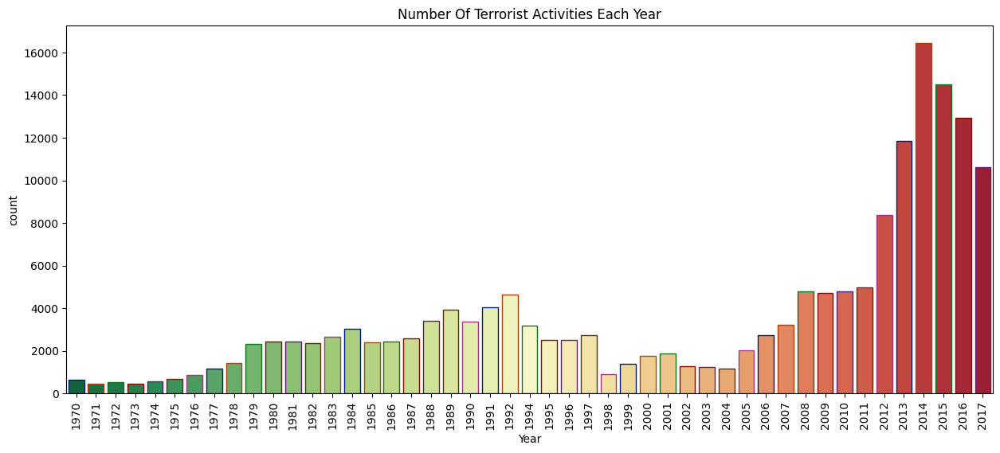

In [56]:
plt.subplots(figsize=(15,6))
sns.countplot(x='Year', data=Data, palette='RdYlGn_r', edgecolor=sns.color_palette('dark', 7))

plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

**Insights**

- From the above Graph we can clearly see that the Year **2014** is the most Affected Year in the entire Time-Frame.
- The subsequent years are **2015**,**2016** & **2013**.

In [57]:
fig=px.histogram(Data,
                 x='Year',nbins=47,
                 marginal="violin",
                 title="Distribution Curve for the total number of Attacks",
                 text_auto=True,
                 template='plotly_dark')
fig.show()

 **Insights-**
 - The total number of attacks in 2014-2015  crossed **30000** mark in the world wide region.
 
 - From the above Distribution curve it is clearly visible that from the Year around 2009 till 2014-16 the number of terror activities recorded the most.
 
 - Since 2014 onwards there is a gradual decrease in the attacks.
 
 - The Graph clearly depicts a huge spike in the number of attacks post Year 2004.

### Let's check the Top terrorist groups responsible for the most number of attacks around the world within the time frame of 47 years

In [58]:
Terrorrist_group=Data.Group.value_counts()[:20].drop("Unknown")
Terrorrist_group

Taliban                                             7294
Islamic State of Iraq and the Levant (ISIL)         5198
Shining Path (SL)                                   3730
Al-Shabaab                                          3262
New People's Army (NPA)                             2679
Farabundo Marti National Liberation Front (FMLN)    2503
Irish Republican Army (IRA)                         2447
Boko Haram                                          2383
Revolutionary Armed Forces of Colombia (FARC)       2354
Kurdistan Workers' Party (PKK)                      2229
Basque Fatherland and Freedom (ETA)                 1889
Communist Party of India - Maoist (CPI-Maoist)      1844
Maoists                                             1603
Liberation Tigers of Tamil Eelam (LTTE)             1567
National Liberation Army of Colombia (ELN)          1387
Tehrik-i-Taliban Pakistan (TTP)                     1337
Palestinians                                        1106
Houthi extremists (Ansar Allah)

In [59]:
type(Terrorrist_group)

pandas.core.series.Series

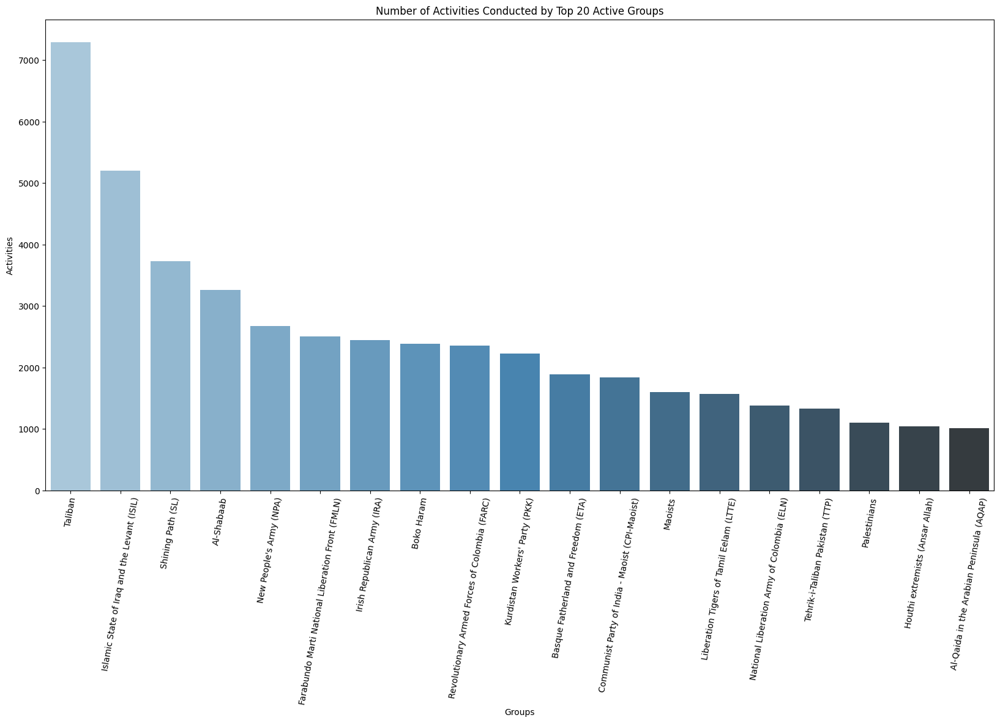

In [61]:
plt.subplots(figsize=(20, 10))
plt.xlabel('Groups')
plt.ylabel("Activities")
plt.title("Number of Activities Conducted by Top 20 Active Groups")
plt.xticks(rotation=80)
sns.barplot(x=Terrorrist_group.index, y=Terrorrist_group.values, palette='Blues_d')

plt.style.use("dark_background")
plt.show()

In [62]:
fig=px.line(x=Terrorrist_group.index,
            y=Terrorrist_group,
            title="Top 20 Terror-Groups",
            labels={'x':"Terrorist-Groups","y":"Number of Attacks"},
            markers=True,
            template='plotly_dark')
fig.update_yaxes(rangemode='tozero')
fig.show()

**Insights-**
- From the graphs it can easily derived that the most numbers of attacks are conducted by **Taliban** group.
- The graph shows that over 7000 activities has been occurred over the globe which has the direct relation to the **Taliban** Group.
- On the graph we have the Top 20 active terrorist group with the numbers of attack conducted by them through the time frame of our dataset i.e 47 years

### Let's Visulalize the activites conducted in different Regions

In [65]:
Data.Region.unique()

array(['Central America & Caribbean', 'North America', 'South America',
       'Western Europe', 'Eastern Europe', 'Sub-Saharan Africa',
       'Southeast Asia', 'Middle East & North Africa', 'East Asia',
       'Australasia & Oceania', 'South Asia', 'Central Asia'],
      dtype=object)

In [66]:
Data.Region.nunique()

12

In [67]:
Regions=Data.Region.value_counts()
Regions

Middle East & North Africa     48596
South Asia                     43462
Sub-Saharan Africa             17009
South America                  16434
Western Europe                 15009
Southeast Asia                 12037
Central America & Caribbean     8936
Eastern Europe                  5005
North America                   3331
East Asia                        702
Central Asia                     553
Australasia & Oceania            270
Name: Region, dtype: int64

In [68]:
fig= px.area(data_frame= Data,x=Regions.index,y=Regions.values,
             title="Region-Wise Attack Counts",template='plotly_dark',
             #height=900,
             #width=1000,
             #color="Region",
             markers = True,labels={'x':"Regions","y":"Number of Attacks"}
            )
fig.update_yaxes(rangemode="tozero")
fig.show()


**Insights-**
- As per the graphs it is clearly depicted that the Middle-East & North Africa are the most prominent region for the Terrorism.
- In Western Regions like Europe, Central America, Eastern Europe the activities are in lesser numbers.
- The activities in EAST-ASIA, CENTRAL-ASIA region are very few among with Australasia.
- As per the graph only 270 attacks are conducted in the Australasia & Oceania region in comparison of almost 49000 attacks in Middle East & North Africa Region

### Let's Now Analyse the Most Affected Countries

In [69]:
Data.Country.value_counts()

Iraq                   23464
Pakistan               13765
Afghanistan            12501
India                  11558
Colombia                7425
                       ...  
St. Lucia                  1
Antigua and Barbuda        1
Andorra                    1
North Korea                1
Wallis and Futuna          1
Name: Country, Length: 205, dtype: int64

C:\Users\akgat\AppData\Local\Temp\ipykernel_17080\1773594900.py:1: FutureWarning:

In a future version of pandas all arguments of Series.dropna will be keyword-only.



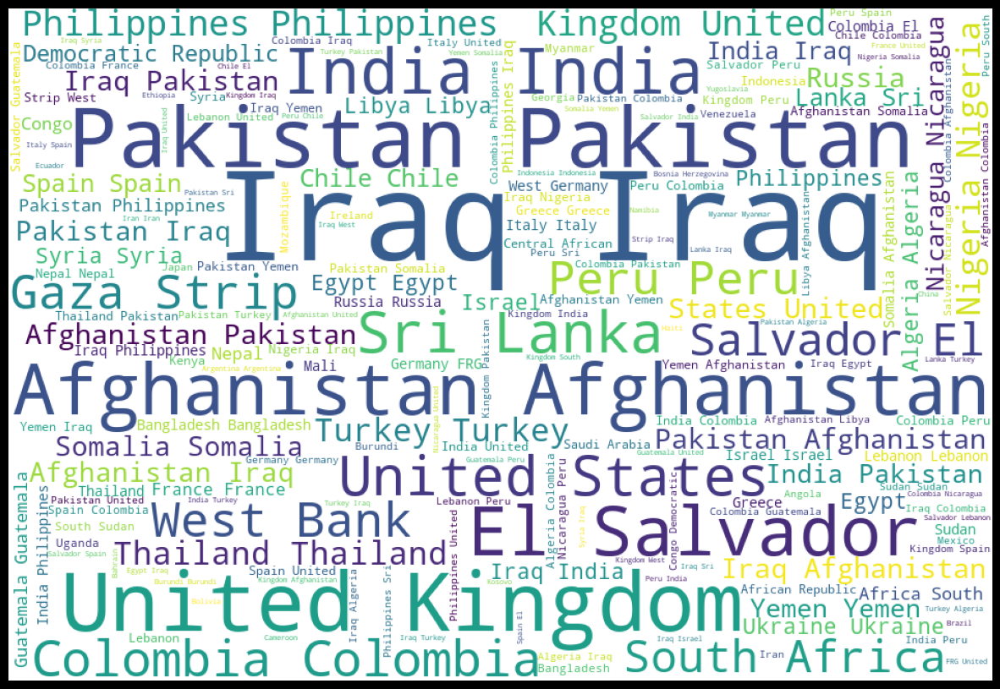

In [70]:
Countries=Data.Country.dropna(False)
plt.subplots(figsize=(15,20))
wordcloud= WordCloud(background_color='white', width=950, height = 650).generate(' '.join(Countries))
plt.axis('off')
plt.imshow(wordcloud)
plt.show();

**Insights-**
- It is clearly visible that **IRAQ** is the most affected nation across the Globe followed by **AFGHANISTAN** &  **PAKISTAN**.
- Very few Activities has been reported from **ISRAEL** & **Russia**.
- **Nigeria**,**Algeria**,**Somalia**, are some of the most affected country from the **South Africa** region.

### Let's check the Top 20 Countries affected by Terrorism

In [71]:
Attacked_country= Data.Country.value_counts()[:20]

In [72]:
Attacked_country

Iraq              23464
Pakistan          13765
Afghanistan       12501
India             11558
Colombia           7425
Philippines        6739
Peru               5006
United Kingdom     4970
El Salvador        4258
Somalia            4108
Turkey             4062
Nigeria            3834
Thailand           3729
Yemen              3305
Spain              3030
Sri Lanka          2898
United States      2763
Algeria            2692
Lebanon            2411
Egypt              2406
Name: Country, dtype: int64

In [73]:
fig =px.bar(Data,
               x=Attacked_country.index,
               y=Attacked_country.values,
               opacity=0.6,
               color=Attacked_country.index,
               labels={'x':'Country','y':"No of Activites"},
               title="Top 20 Affected Countries",
               template='plotly_dark',
               width=900,
               height=400
           )
fig.show()

**Useful Points**
- From the graph we can see that **Pakistan** , **Afghanistan** and **India** are at Top 4 places, that clearly show how much vulnerable these countries are to these activities.
- It is very well Depicted from the Graph that the European Countries has very less number of Occurrences of Terrorist activities as compared to South East Asian Countries.

### Let's visualize the percentage of each type of attack that occurred  across the World geography.

In [74]:
Data['Attack_Type'].unique()

array(['Assassination', 'Armed Assault', 'Bombing/Explosion',
       'Facility/Infrastructure Attack', 'Hijacking', 'Unknown',
       'Hostage Taking (Kidnapping)', 'Unarmed Assault',
       'Hostage Taking (Barricade Incident)'], dtype=object)

In [75]:
type_attack=Data.Attack_Type.value_counts()

In [76]:
type(type_attack)

pandas.core.series.Series

In [77]:
fig =px.pie(Data,
            values=type_attack,
            names=type_attack.index,
            title=" Frequency of Attack Type in World-Wide Region")
fig.show()

- From the Pie chart The Attack-Type - **Bombing** captures around **48%** of the total activities.
- It is almost of the half of the activities that has been conducted all across the world.
- From the Graph we can conclude that the Terror-groups were intently conducting Bombing/Explosions. 
- Armed Assault activities takes about 24% of the total activities.However the **Assassination** activities takes occupies 11% of total activities.

In [78]:
Data.head(2)

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude
0,1970,7,2,Dominican Republic,Unknown,Central America & Caribbean,Assassination,Julio Guzman,1.0,0.0,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,NaN,-69.951164,18.456792
5,1970,1,1,United States,Illinois,North America,Armed Assault,Cairo Police Headquarters,0.0,0.0,1/1/1970: Unknown African American assailants ...,Black Nationalists,Police,Firearms,To protest the Cairo Illinois Police Deparment,NaN,-89.176269,37.005105



**Let's take the account of total casualties and add it up as a separate column on the dataset**

In [79]:
Data["Casualties"]= Data["Wounded"]+Data["Killed"]

**Here we have added another column "CASUALITIES" to the dataset.**

In [80]:
Data.shape

(171344, 19)

In [81]:
Data.Casualties

0         1.0
5         0.0
6         0.0
7         0.0
8         0.0
         ... 
181686    3.0
181687    9.0
181688    0.0
181689    0.0
181690    0.0
Name: Casualties, Length: 171344, dtype: float64

### Q1- Find out the Total number of casualties recorded for the **MOST AFFECTED YEAR** by different Weapon Types

In [82]:
Most_Affected_Year=df["Year"].value_counts().idxmax()
Most_Affected_Year

2014

In [83]:
fig = px.scatter(Data.query("Year==2014"),
                 title="Distribution for the Casualties across the Regions",
                 x="Casualties",
                 y="Region",
                 color="Region",
                 hover_name="Country",
                 animation_frame= "Weapon_type",template="plotly_dark",
                 #width=1000,
                 #height=550,
                 log_x=True
                )
fig.show()

### Q2- What is the Relation between the type of Attack and the number of Deaths caused by each of them Year wise.

In [84]:
fig=px.histogram(Data,x="Attack_Type",y="Killed",
                 title =" Year- Wise Trends on the Weapons Usage and number of Deaths ",
                 animation_frame=Data['Year'],
                 width=1000,
                 height=800,
                 template='plotly_dark'
                )
fig.update_yaxes(range = [0,1000])
fig.show()

- From the graph we can clearly see that the **Bombing/Explosion** activities has a major impact on the number of deaths reported.

- **Bombing/Explosion** & **Assassination** activities keeps on increasing  which can be seen as we move forward in the graphical animation.

- The Increase in **Assassination** activities within a particular region or country is an alarming signs that needs to be taken care of.



### Q3- Calculate the rate of increase in the Terrorist Activities within the time frame of the dataset

In [85]:
Year=Data.Year.value_counts().to_dict()
rate=((Year[2017]-Year[1970])/Year[2017])*100
print(Year[1970],'attacks happened in 1970 &',Year[2017],'attacks happened in 2017')
print('So the number of attacks from 1970 has increased by',np.round(rate,0),'% till 2017')

628 attacks happened in 1970 & 10621 attacks happened in 2017
So the number of attacks from 1970 has increased by 94.0 % till 2017


<Figure size 1500x1000 with 0 Axes>

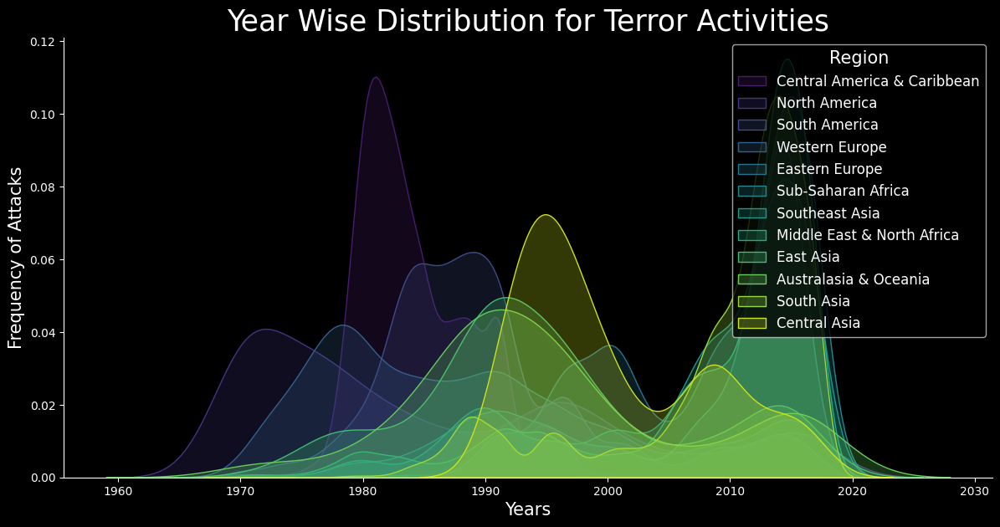

In [87]:
plt.figure(figsize=(15, 10))
g = sns.FacetGrid(Data, hue='Region', height=6, aspect=2, palette='viridis')
g.map(sns.kdeplot, 'Year', fill=True, common_norm=False)

plt.title('Year Wise Distribution for Terror Activities', fontsize=25)
plt.xlabel('Years', fontsize=15)
plt.ylabel('Frequency of Attacks', fontsize=15)
plt.legend(title='Region', title_fontsize=15, fontsize=12)

plt.show()

### Q4- What are the Worst Terror Attacks in the history causing the most casualties? 

In [88]:
trr1 = Data.sort_values(by='Casualties',ascending=False)[:50]

heat=trr1.pivot_table(index='Country',columns='Year',values="Casualties")

heat.fillna(0,inplace=True)
colorscale = [[0, '#edf8fb'], [.3, '#00BFFF'],  [.6, '#8856a7'],  [1, '#810f7c']]
heatmap = go.Heatmap(z=heat.values, x=heat.columns, y=heat.index,colorscale=colorscale)
data = [heatmap]
layout = go.Layout(
    title='Top 50 Worst Terror Attacks in History from 1982 to 2016')
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='heatmap',show_link=False)

### Q5- What are the top most Affected States of INDIA?

In [89]:
India_DF= Data[(Data.Country=="India")]

In [90]:
India_DF

,Year,Month,Day,Country,State,Region,Attack_Type,Target,Killed,Wounded,Summary,Group,Target_type,Weapon_type,Motive,Location,Longitude,Latitude,Casualties
1186,1972,2,22,India,Delhi,South Asia,Hijacking,B-747,0.0,0.0,NaN,Palestinians,Airports & Aircraft,Explosives,NaN,NaN,77.153336,28.585836,0.0
2764,1975,1,2,India,Bihar,South Asia,Bombing/Explosion,Lalit Narayan Mishra and a legislator,4.0,0.0,"1/2/1975: The Indian Railway Minister, Lalit N...",Ananda Marga,Government (General),Explosives,Unknown,The attack occurred in the town,85.781004,25.863042,4.0
3857,1976,5,26,India,Delhi,South Asia,Bombing/Explosion,New Delhi airport,0.0,0.0,NaN,Unknown,Airports & Aircraft,Explosives,NaN,NaN,77.153336,28.585836,0.0
5327,1977,9,28,India,Maharashtra,South Asia,Hijacking,DC-8,0.0,0.0,NaN,Japanese Red Army (JRA),Airports & Aircraft,Firearms,NaN,NaN,72.877656,19.075984,0.0
7337,1979,1,13,India,Assam,South Asia,Armed Assault,patrol,0.0,0.0,NaN,Naga People,Police,Firearms,NaN,NaN,92.937574,26.200605,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181663,2017,12,30,India,Kerala,South Asia,Bombing/Explosion,Koothuparamba Police Station,0.0,0.0,12/30/2017: Assailants threw an explosive devi...,Unknown,Police,Explosives,"The specific motive is unknown; however, sourc...",The incident occurred in the Kannur district.,75.565432,11.831902,0.0
181665,2017,12,30,India,Chhattisgarh,South Asia,Facility/Infrastructure Attack,Road Construction Site,0.0,0.0,12/30/2017: Assailants set fire to seven vehic...,Communist Party of India - Maoist (CPI-Maoist),Business,Firearms,"The specific motive is unknown; however, sourc...",The incident occurred in the Dantewada district.,81.497666,18.802725,0.0
181672,2017,12,31,India,Jammu and Kashmir,South Asia,Armed Assault,Camp,8.0,3.0,12/31/2017: Assailants armed with grenades and...,Jaish-e-Mohammad (JeM),Police,Explosives,"The specific motive is unknown; however, sourc...",The incident occurred in the Pulwama district.,74.964225,33.966527,11.0
181684,2017,12,31,India,Assam,South Asia,Hostage Taking (Kidnapping),Personal Security Officer of Council Member Ih...,0.0,0.0,12/31/2017: Assailants abducted Prafulla Phuka...,Zeliangrong United Front,Government (General),Firearms,NaN,The incident occurred in the Dima Hasao distri...,93.015788,25.180162,0.0


## Summary and Conclusion

In the above project, we discovered some meaningful insights regarding the Global Terrorism activities. We have explored the dataset downloaded from Kaggle and laid out graphical interpolation about the trends of the top affected countries, regions, most active Terror groups, derived by the activities.

From the insights we can now conclude that the Global Terrorism activities are appreciably affecting only some of the Region where these activities are mostly occurred by the prominent Terror Groups.

FUTURE Scopes -

We can select different country or a Regions and perform deep analysis for the Terrorism activities trends and can prepare a report mentioning the difference between the respective countries or Regions.